In [1]:
import tqdm
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

In [23]:
df_cad = pd.read_csv("./processed_data/cadastro_geo.csv")
df_medicoes = pd.read_csv("./processed_data/medicoes_texto_corrigido.csv")
df_qualificacao = pd.read_csv("./processed_data/nova_qualificacao_torre.csv")
df_risco = pd.read_csv("./processed_data/risco_cluster.csv")

## Analise das Torres


#### Distribuição da Qualificação

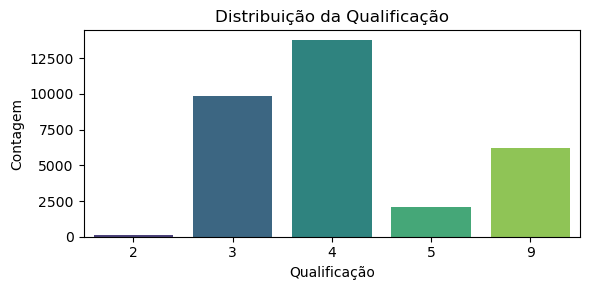

In [24]:
# Get value counts
qual_counts = df_qualificacao['Qualificacao'].value_counts().reset_index()
qual_counts.columns = ['Qualificacao', 'Count']

# Create a bar plot using seaborn
plt.figure(figsize=(6, 3))
sns.barplot(x='Qualificacao', y='Count', data=qual_counts, palette='viridis')
plt.title('Distribuição da Qualificação')
plt.xlabel('Qualificação')
plt.ylabel('Contagem')
plt.xticks(rotation=0)
plt.tight_layout()
plt.show()

#### Distribuição Espacial das Torres

In [42]:
df_cad[~df_cad['cluster_geo'].isna()]

,Equipamento,Linha de Transmissão,Denominação,Classe,Código ABC,Tensão,Latitude,Longitude,cluster_geo
0,115280,LT31,Torre 111,L_TORRE_AUTOPORT,C,230,-22.977610,-50.056523,3.0
1,115281,LT31,Torre 112,L_TORRE_AUTOPORT,C,230,-22.979172,-50.053168,3.0
2,115282,LT31,Torre 113,L_TORRE_AUTOPORT,C,230,-22.980874,-50.049499,3.0
3,115283,LT31,Torre 114,L_TORRE_AUTOPORT,C,230,-22.983017,-50.044919,3.0
4,115284,LT31,Torre 115,L_TORRE_AUTOPORT,C,230,-22.984675,-50.041349,3.0
...,...,...,...,...,...,...,...,...,...
36224,248914,LT4272,Torre 001A,L_TORRE_AUTOPORT,C,345,-23.659804,-46.724611,1.0
36225,248915,LT4272,Torre 002A,L_TORRE_AUTOPORT,C,345,-23.657644,-46.724533,1.0
36226,295034,LT4272,Torre 055,L_TORRE_AUTOPORT,C,345,-23.527798,-46.753380,1.0
36227,302615,LT4272,Torre 000-P,L_PORTICO,C,345,-23.659282,-46.724309,1.0


In [44]:
import folium
import matplotlib

aux = df_cad[~df_cad['Latitude'].isna()]
aux = aux[~aux['cluster_geo'].isna()]
df_map = aux

cluster_values = sorted(df_map['cluster_geo'].unique())
colors = plt.cm.viridis(np.linspace(0, 1, len(cluster_values)))
color_dict = dict(zip(cluster_values, colors))

center_lat = df_map['Latitude'].mean()
center_lon = df_map['Longitude'].mean()

m = folium.Map(location=[center_lat, center_lon], zoom_start=10)

for idx, row in df_map.iterrows():
    cluster = row['cluster_geo']
    color = matplotlib.colors.rgb2hex(color_dict[cluster])
    
    popup_text = f"""
    <b>Cluster:</b> {row['cluster_geo']}<br>
    """
    
    try:
        folium.CircleMarker(
            location=[row['Latitude'], row['Longitude']],
            radius=5,
            color=color,
            fill=True,
            fill_color=color,
            fill_opacity=0.7,
            popup=folium.Popup(popup_text, max_width=300)
        ).add_to(m)
    except Exception as e:
        print(f"Error with row {idx}: {e}")


legend_html = '''
<div style="position: fixed; 
     bottom: 50px; right: 50px; width: 150px; height: 120px; 
     border:2px solid grey; z-index:9999; font-size:14px;
     background-color:white; padding: 10px;
     ">
     <p><b>Clusters</b></p>
'''

for cluster in cluster_values:
    color = matplotlib.colors.rgb2hex(color_dict[cluster])
    legend_html += f'''
    <p><i class="fa fa-circle" style="color:{color}"></i> Cluster {cluster}</p>
    '''
    
legend_html += '</div>'

m.get_root().html.add_child(folium.Element(legend_html))


m



#### Distribuição Espacial da Qualificação

In [ ]:
import folium
import matplotlib


df_map = df_qualificacao.merge(df_cad, on='Equipamento', how='inner')
df_map = df_map.merge(df_cad, on='Equipamento', how='inner')

qualificacao_values = sorted(df_map['Qualificacao'].unique())
colors = plt.cm.viridis(np.linspace(0, 1, len(qualificacao_values)))
color_dict = dict(zip(qualificacao_values, colors))

center_lat = df_map['Latitude'].mean()
center_lon = df_map['Longitude'].mean()
m = folium.Map(location=[center_lat, center_lon], zoom_start=10)

for idx, row in df_map.iterrows():
    qual = row['Qualificacao']
    color = matplotlib.colors.rgb2hex(color_dict[qual])
    
    popup_text = f"""
    <b>Equipamento:</b> {row['Equipamento']}<br>
    <b>Denominação:</b> {row['Denominação']}<br>
    <b>Qualificação:</b> {row['Qualificacao']}<br>
    <b>Classe:</b> {row['Classe']}<br>
    <b>Linha:</b> {row['Linha de Transmissão']}
    """
    try:
        folium.CircleMarker(
            location=[row['Latitude'], row['Longitude']],
            radius=5,
            color=color,
            fill=True,
            fill_color=color,
            fill_opacity=0.7,
            popup=folium.Popup(popup_text, max_width=300)
        ).add_to(m)
    except Exception as e:
        ...

legend_html = '''
<div style="position: fixed; 
     bottom: 50px; right: 50px; width: 150px; height: 120px; 
     border:2px solid grey; z-index:9999; font-size:14px;
     background-color:white;
     padding: 10px;
     border-radius: 5px;
     ">
     <p style="margin-top: 0; margin-bottom: 5px;"><b>Qualificação</b></p>
'''

for qual in sorted(qualificacao_values):
    color = matplotlib.colors.rgb2hex(color_dict[qual])
    legend_html += f'<p style="margin: 2px;"><span style="background-color:{color}; border-radius:50%; display:inline-block; width:10px; height:10px;"></span> {qual}</p>'

legend_html += '</div>'

m.get_root().html.add_child(folium.Element(legend_html))

# Display the map
m


#### Outras Variaveis da Torres

In [50]:
print("Quantidade de Linhas", df_cad['Linha de Transmissão'].unique().shape[0])

Quantidade de Linhas 272


#### Dados Faltantes

## Analise de Risco

## Analise de Medições

In [4]:
df_qualificacao.head()

,Equipamento,Score,Qualificacao,Linha de Transmissão,Denominação,Classe,Código ABC,Tensão,Latitude,Longitude
0,100001,-1.000000,9,LT9142,Torre 000-P,L_PORTICO,C,69,-24.108815,-49.324733
1,100002,-1.000000,9,LT9142,Torre 001,L_TORRE_AUTOPORT,C,69,-24.108504,-49.324777
2,100003,0.616929,4,LT9142,Torre 002,L_TORRE_AUTOPORT,C,69,-24.108324,-49.323791
3,100004,0.670614,4,LT9142,Torre 003,L_TORRE_AUTOPORT,C,69,-24.107320,-49.319415
4,100005,-1.000000,9,LT9142,Torre 004,L_TORRE_AUTOPORT,C,69,-24.106687,-49.316652
